# Novel Approaches to Emergency Flood Detection When Satellite Images Fail using Image Segmentation

The code below was run on a Macbook Pro with 64GB RAM. I did not run parallel jobs. Run-time is relatively fast due to the small dataset and models chosen for the problem.

Acknowledgement: ChatGPT was used as a starting point when generating code to faciliate faster coding. Consequently some of the comments were generated by ChatGPT.

In [96]:
import numpy as np
import os
import matplotlib.pyplot as plt
import os
from skimage import io, color, img_as_ubyte
from PIL import Image, ImageOps
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV, cross_val_score, cross_val_predict
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import make_scorer, accuracy_score, confusion_matrix
from sklearn.svm import SVC
from skimage.feature.texture import graycomatrix, graycoprops
from skimage.measure import label, regionprops
from scipy.stats import entropy

In [97]:
# set random seed
np.random.seed(33024)

## Data Preprocessing and Exploratory Analysis

5 categories of water body proximity: <br>
0 - in immediate proximity <br>
1 - close <br>
2 - moderately close <br>
3 - moderately far <br>
4 - very far <br>

Below I label them, store the labels and plot the distribution of the data.

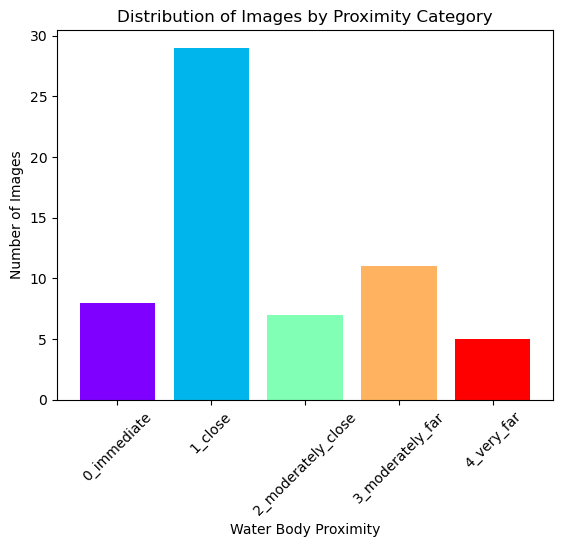

In [98]:
# Path to the main folder
folder_path = './Water_body_images/'

# Dictionary to hold the count of images in each subfolder
image_counts = {}

# Iterate through each subfolder and count the .png files
for subfolder in os.listdir(folder_path):
    subfolder_path = os.path.join(folder_path, subfolder)
    if os.path.isdir(subfolder_path):
        count = len([f for f in os.listdir(subfolder_path) if (f.endswith('.JPG') or f.endswith('.jpeg') or f.endswith('.jpg'))])
        image_counts[subfolder] = count

# Sort the labels (subfolder names) alphabetically
sorted_labels = sorted(image_counts.keys())

# Sorted counts corresponding to the sorted labels
sorted_counts = [image_counts[label] for label in sorted_labels]

# Creating the bar chart
plt.bar(sorted_labels, sorted_counts, color=plt.cm.rainbow(np.linspace(0, 1, len(sorted_labels))))
plt.xlabel('Water Body Proximity')
plt.ylabel('Number of Images')
plt.title('Distribution of Images by Proximity Category')
plt.xticks(rotation=45)  # Rotates the labels for better readability
plt.show()

In [99]:
# Check that the numbers sum to 60
np.sum(value for value in image_counts.values())

/var/folders/g2/gc7sg8w57kd04_74m3t1zyy80000gn/T/ipykernel_27189/2603318073.py:2: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  np.sum(value for value in image_counts.values())


60

## Image Segmentation

I tried edge-based segmentation and the unseeded region growing algotithm, but the optimal parameters varied too much across different proximity categories, so I decided to go for another method: identify blue-ish colour regions and then apply a texture filter to identify water. The code below performs the first step i.e. find the blue regions. A sample of the first 4 images in each proximity category is shown.

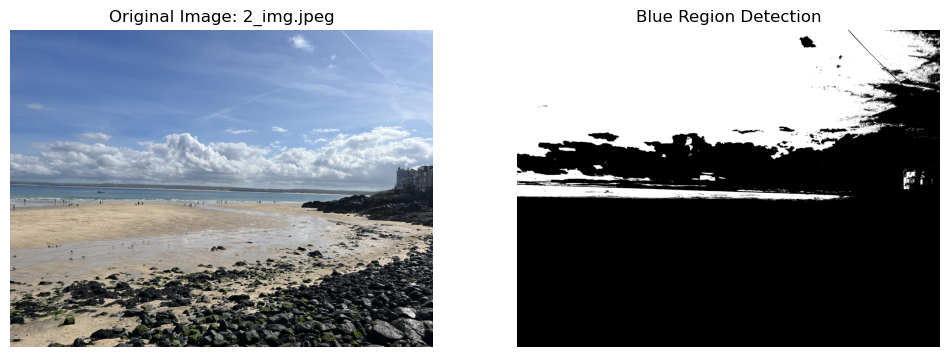

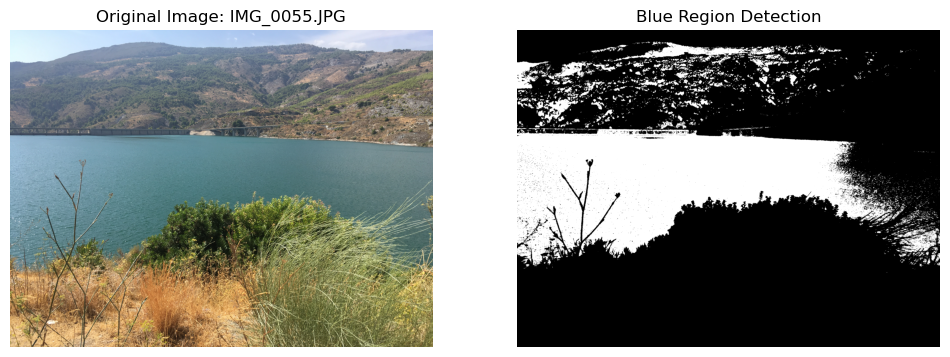

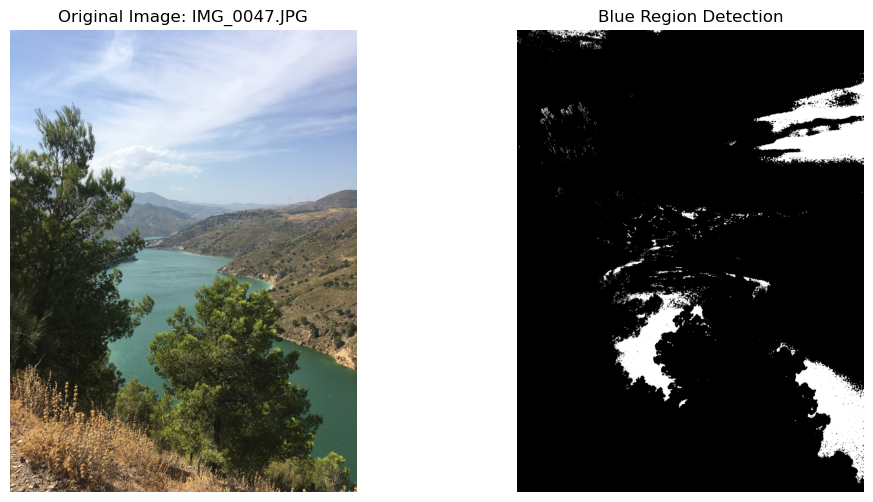

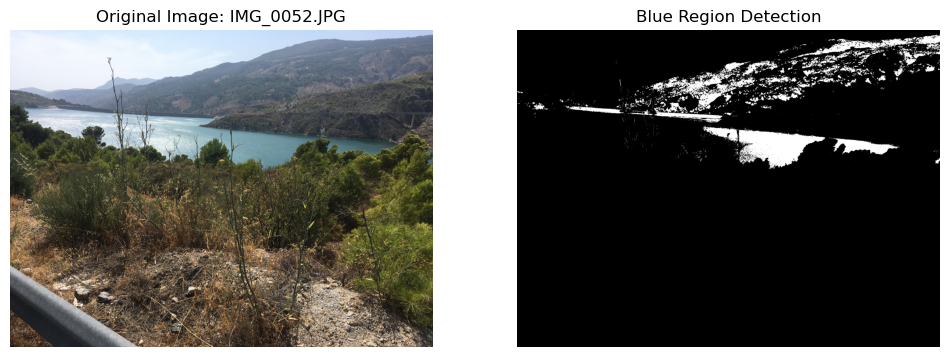

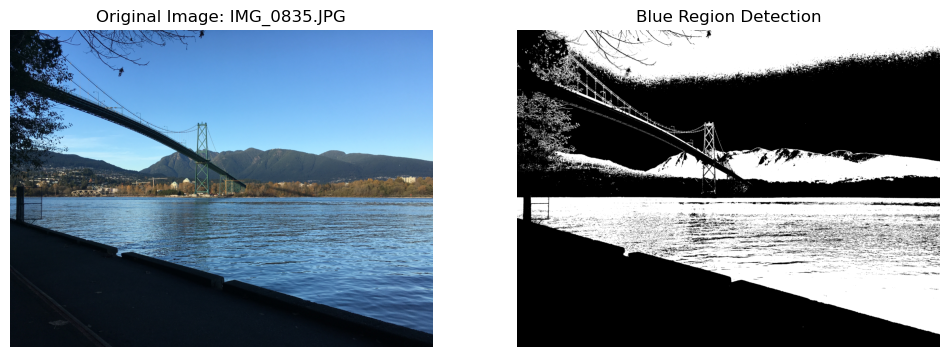

...

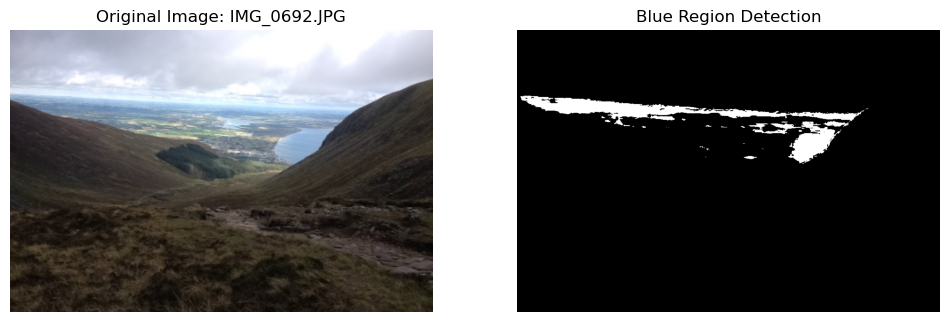

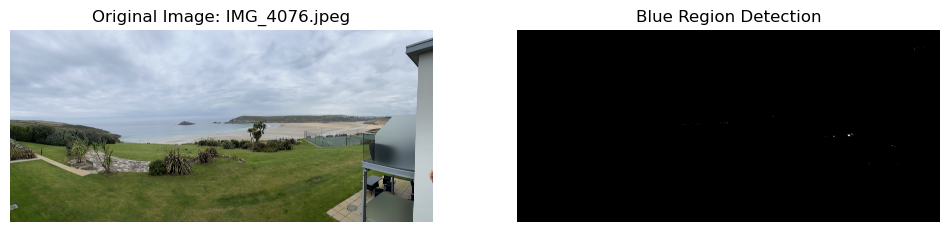

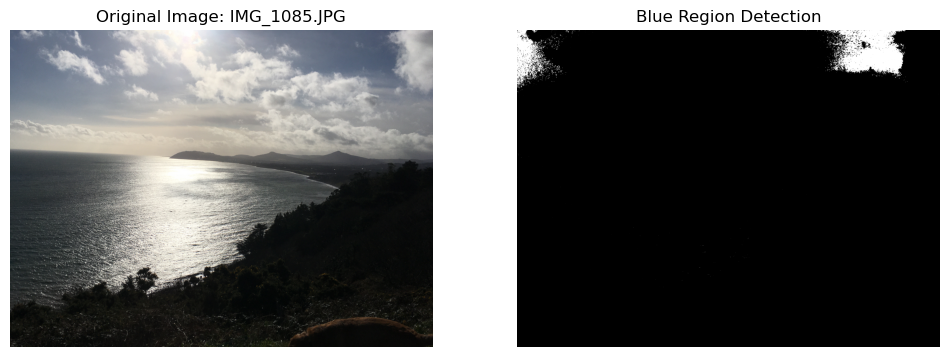

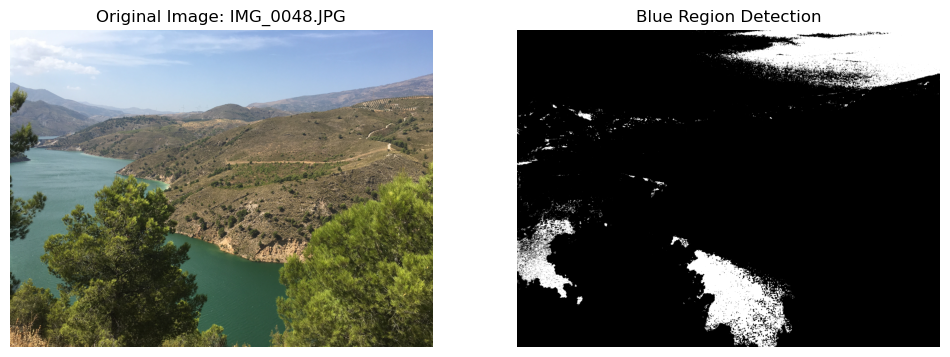

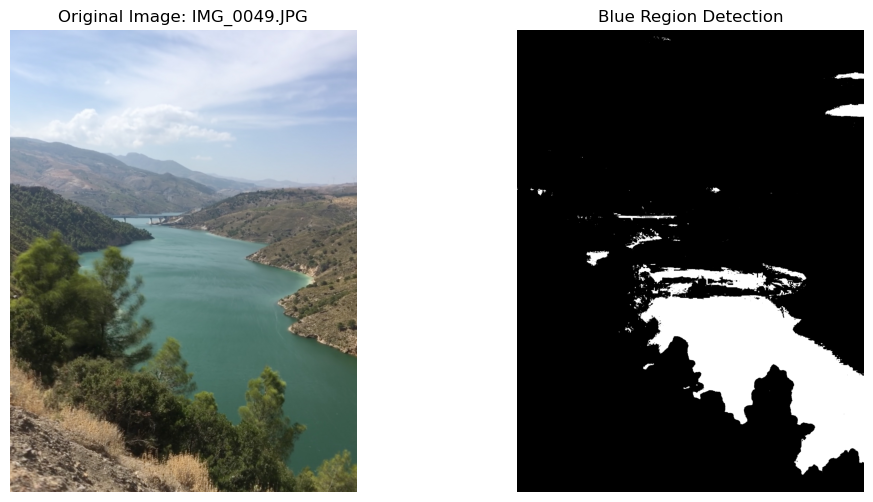

In [100]:
# Path to the main folder
main_folder_path = './Water_body_images/'

# List all subfolders in the main folder
subfolders = [os.path.join(main_folder_path, f) for f in os.listdir(main_folder_path) if os.path.isdir(os.path.join(main_folder_path, f))]

# Process each subfolder
for folder in subfolders:
    # Get the paths of the first four images in the subfolder
    image_paths = [os.path.join(folder, f) for f in os.listdir(folder) if f.endswith(('.JPG', '.jpeg', '.jpg'))][:4]

    # Process each image in the subfolder
    for img_path in image_paths:
        pil_img = Image.open(img_path)
        pil_img = ImageOps.exif_transpose(pil_img)  # Automatically correct orientation
        img = np.array(pil_img)  # Convert to numpy array for further processing
        img_hsv = color.rgb2hsv(img)  # Convert to HSV color space

        # Define blue color range in HSV
        lower_blue = np.array([0.4, 0.25, 0.3])  # Adjust these values
        upper_blue = np.array([0.8, 1.0, 0.9])  # Adjust these values

        # Create a mask for blue regions
        mask = np.logical_and.reduce((img_hsv[:,:,0] >= lower_blue[0], img_hsv[:,:,0] <= upper_blue[0],
                                      img_hsv[:,:,1] >= lower_blue[1], img_hsv[:,:,1] <= upper_blue[1],
                                      img_hsv[:,:,2] >= lower_blue[2], img_hsv[:,:,2] <= upper_blue[2]))

        # Set up the figure with two subplots
        plt.figure(figsize=(12, 6))

        # Original Image
        plt.subplot(1, 2, 1)
        plt.imshow(img)
        plt.title(f'Original Image: {os.path.basename(img_path)}')
        plt.axis('off')

        # Masked Image
        plt.subplot(1, 2, 2)
        plt.imshow(mask, cmap='gray')
        plt.title(f'Blue Region Detection')
        plt.axis('off')

        plt.show()


Next I try to isolate the water region by applying a texture filter. A sample of the first 4 images in each proximity category is shown.

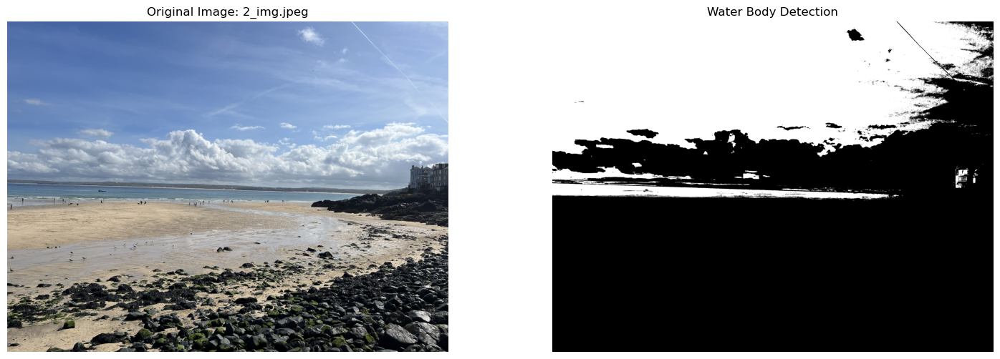

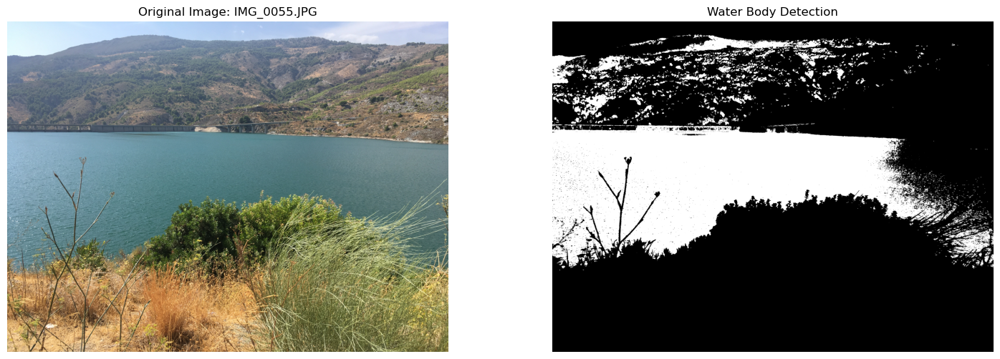

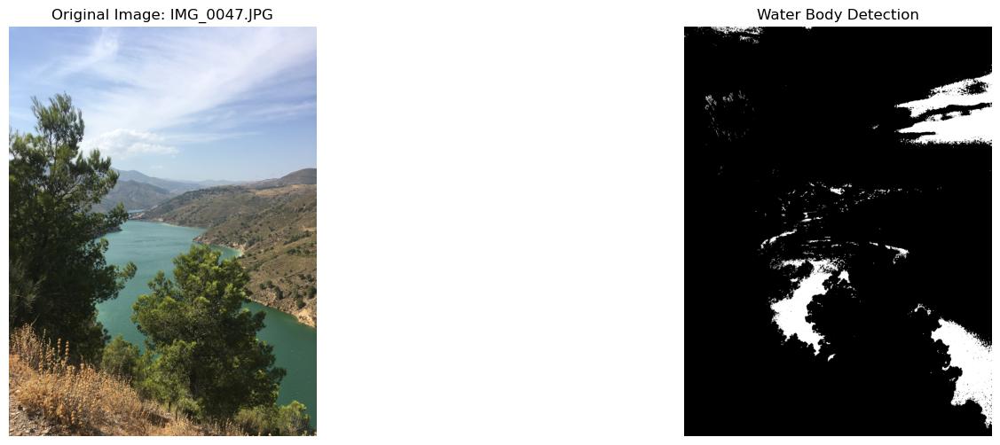

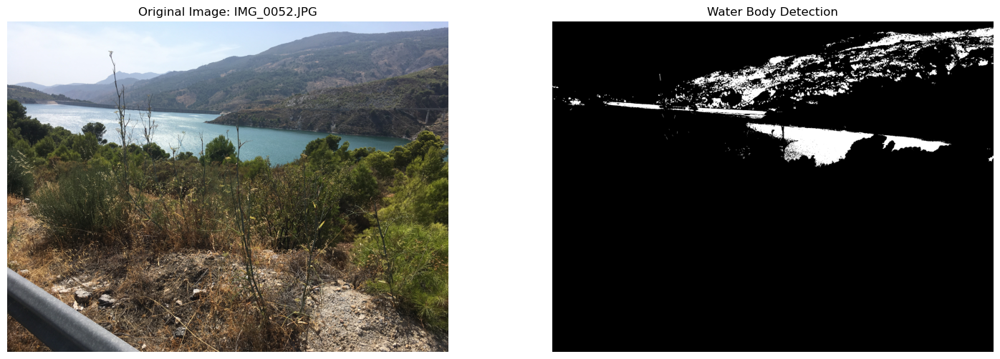

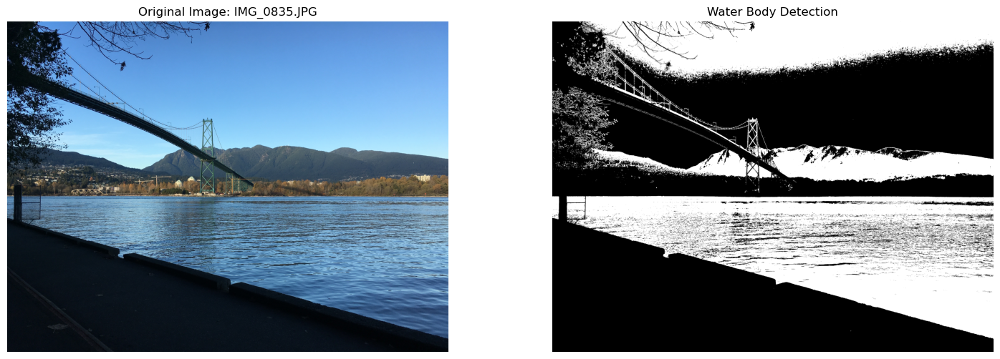

...

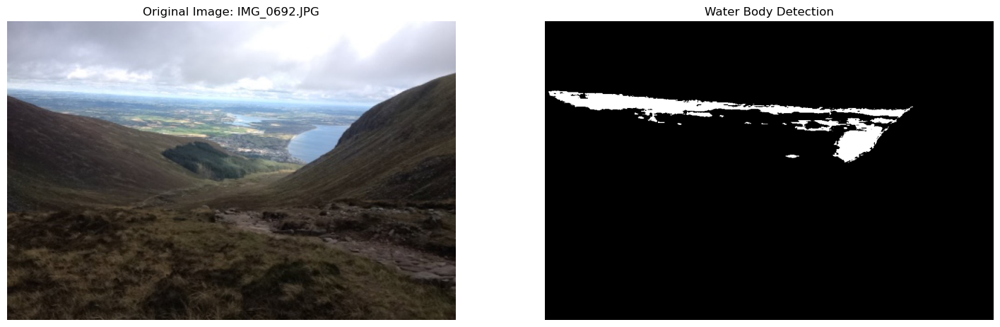

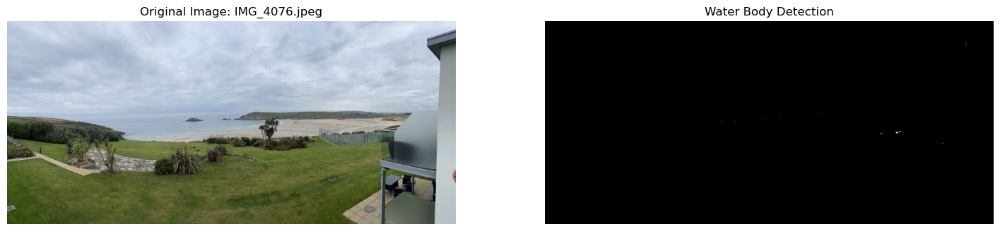

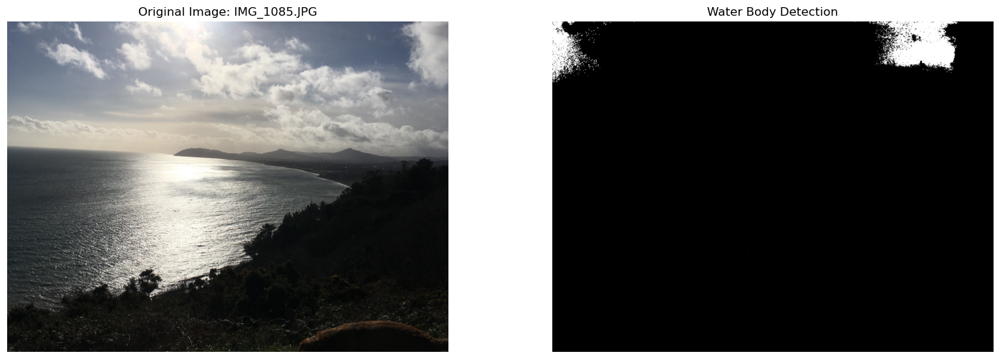

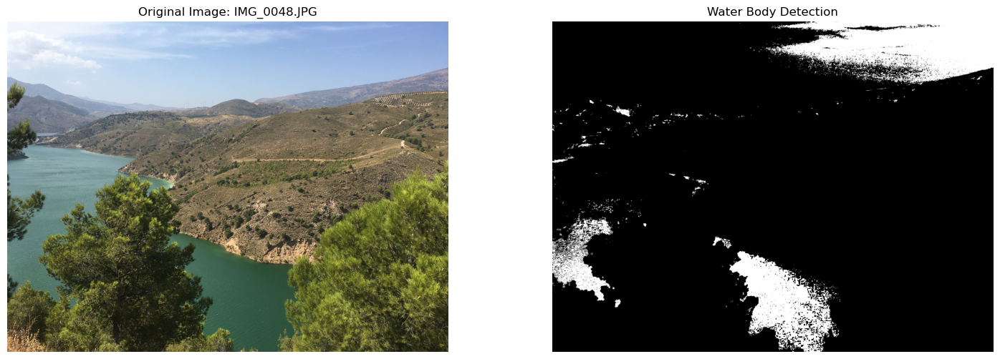

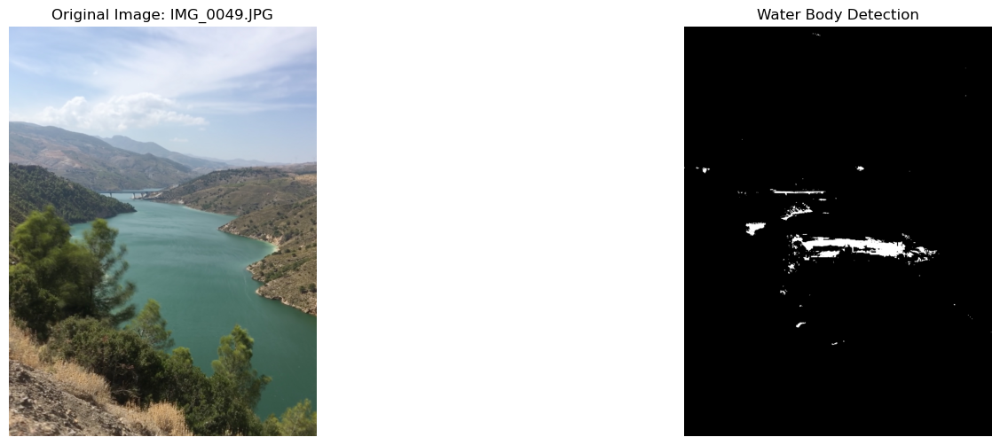

In [101]:
def classify_region_by_texture(sub_img, sub_mask):
    # Create a new sub-image where non-masked areas are set to a constant value
    modified_sub_img = np.zeros_like(sub_img)
    modified_sub_img[sub_mask] = sub_img[sub_mask]

    # Compute GLCM and texture features on the modified sub-image
    glcm = graycomatrix(modified_sub_img, distances=[5], angles=[0], levels=256, symmetric=True, normed=True)
    contrast = graycoprops(glcm, 'contrast')[0, 0]
    homogeneity = graycoprops(glcm, 'homogeneity')[0, 0]

    # I use thresholding conditions on texture parameters to identify water
    # these parameters were tuned by applying to the images and taking equal-sized samples
    # across all proximity categories and adjusting until accuracy was reasonable across all
    if contrast > 40 and homogeneity < 0.8:
        return True  # Classified as water
    return False

# Process each subfolder
for folder in subfolders:
    # Get the paths of the first four images in the subfolder
    image_paths = [os.path.join(folder, f) for f in os.listdir(folder) if f.endswith(('.JPG', '.jpeg', '.jpg'))][:4]

    # Process each image in the subfolder
    for img_path in image_paths:
        pil_img = Image.open(img_path)
        pil_img = ImageOps.exif_transpose(pil_img)  # Automatically correct orientation
        img = np.array(pil_img)  # Convert to numpy array for further processing
        img_gray = img_as_ubyte(color.rgb2gray(img))
        img_hsv = color.rgb2hsv(img)  # Convert to HSV color space

         # Define blue color range in HSV
        lower_blue = np.array([0.4, 0.25, 0.3])  # Adjust these values
        upper_blue = np.array([0.8, 1.0, 0.9])  # Adjust these values

        # Create a mask for blue regions
        mask = np.logical_and.reduce((img_hsv[:,:,0] >= lower_blue[0], img_hsv[:,:,0] <= upper_blue[0],
                                      img_hsv[:,:,1] >= lower_blue[1], img_hsv[:,:,1] <= upper_blue[1],
                                      img_hsv[:,:,2] >= lower_blue[2], img_hsv[:,:,2] <= upper_blue[2]))

        # Label connected regions in the mask
        labeled_mask = label(mask)

        # Analyze texture in each labeled region
        water_body_mask = np.zeros_like(img_gray, dtype=bool)
        for region in regionprops(labeled_mask, intensity_image=img_gray):
            minr, minc, maxr, maxc = region.bbox
            sub_img = img_gray[minr:maxr, minc:maxc]
            sub_mask = mask[minr:maxr, minc:maxc]

            if classify_region_by_texture(sub_img, sub_mask):
                water_body_mask[minr:maxr, minc:maxc] = sub_mask  # Use the shape of the original mask

        # Set up the figure with three subplots
        plt.figure(figsize=(18, 6))

        # Original Image
        plt.subplot(1, 2, 1)
        plt.imshow(img)
        plt.title(f'Original Image: {os.path.basename(img_path)}')
        plt.axis('off')

        # Water Body Detection
        plt.subplot(1, 2, 2)
        plt.imshow(water_body_mask, cmap='gray')
        plt.title('Water Body Detection')
        plt.axis('off')

        plt.show()


Below I write a function to extract the relevant spatial and textural features from the water segment in the images (identified in white above).

In [102]:
def calculate_features(img_path):
    pil_img = Image.open(img_path)
    pil_img = ImageOps.exif_transpose(pil_img)  # Correct orientation
    img = np.array(pil_img)
    img_gray = img_as_ubyte(color.rgb2gray(img))
    img_hsv = color.rgb2hsv(img)

    # Define blue color range in HSV
    lower_blue = np.array([0.4, 0.25, 0.3])
    upper_blue = np.array([0.8, 1.0, 0.9])

    # Create a mask for blue regions
    mask = np.logical_and.reduce((img_hsv[:,:,0] >= lower_blue[0], img_hsv[:,:,0] <= upper_blue[0],
                                  img_hsv[:,:,1] >= lower_blue[1], img_hsv[:,:,1] <= upper_blue[1],
                                  img_hsv[:,:,2] >= lower_blue[2], img_hsv[:,:,2] <= upper_blue[2]))

    labeled_mask = label(mask)

    # Initialize quadrant proportions
    quadrant_proportions = np.zeros(4)
    height, width = img_gray.shape
    quadrant_height, quadrant_width = height // 2, width // 2

    for i in range(2):
        for j in range(2):
            quadrant_mask = mask[i*quadrant_height:(i+1)*quadrant_height, j*quadrant_width:(j+1)*quadrant_width]
            water_body_area = np.sum(quadrant_mask)
            quadrant_area = quadrant_height * quadrant_width
            quadrant_proportions[i*2 + j] = water_body_area / quadrant_area

    # Calculate standard deviation and contrast
    std_dev = np.std(img_gray)
    contrast = np.mean(graycomatrix(img_gray, [1], [0], 256, symmetric=True, normed=True))

    # Calculate entropy
    hist = np.histogram(img_gray, bins=256)[0]
    img_entropy = entropy(hist)

    # Calculate correlation
    correlation = np.corrcoef(img_gray.flatten(), np.roll(img_gray, 1).flatten())[0, 1]

    return np.array([*quadrant_proportions, std_dev, contrast, img_entropy, correlation])

In [103]:
def plot_image(image_path):

    # Load the image
    img = Image.open(image_path)

    # Correct the orientation based on EXIF data
    img = ImageOps.exif_transpose(img)

    # Plot the image
    plt.imshow(img)
    plt.axis('off')  # Turn off axis numbers
    plt.show()

Below I perform an eyeball check of the calculated water region proportions in each quadrant.

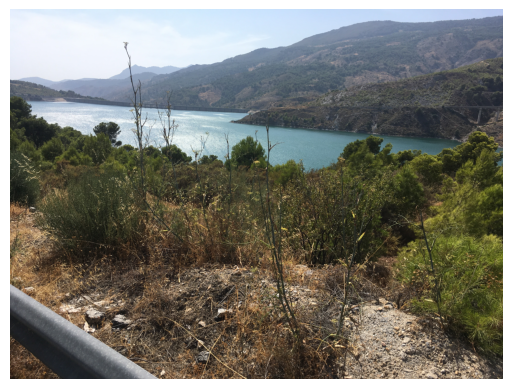

Top left quadrant proportion: 0.06159815392206265
Top right quadrant proportion: 0.15863436423952296
Bottom left quadrant proportion: 0.0
Top right quadrant proportion: 3.280633240950701e-07


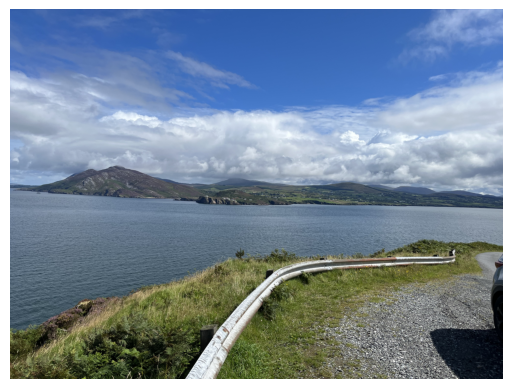

Top left quadrant proportion: 0.5910798926051902
Top right quadrant proportion: 0.5787476641891325
Bottom left quadrant proportion: 0.3793993291761149
Top right quadrant proportion: 0.14163805954480557


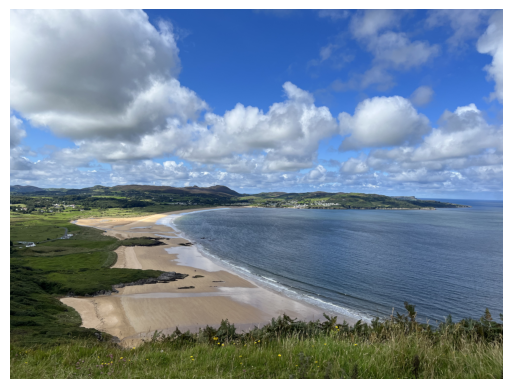

Top left quadrant proportion: 0.39728370128915763
Top right quadrant proportion: 0.7792786674855128
Bottom left quadrant proportion: 0.07115890337616528
Top right quadrant proportion: 0.5324297157134459


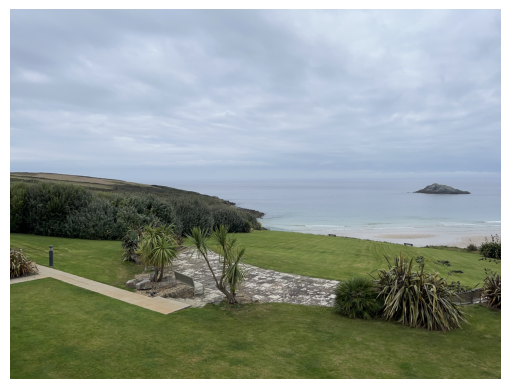

Top left quadrant proportion: 2.3871524817519244e-06
Top right quadrant proportion: 0.0045008054934517
Bottom left quadrant proportion: 1.3640871324296711e-06
Top right quadrant proportion: 1.0230653493222532e-06


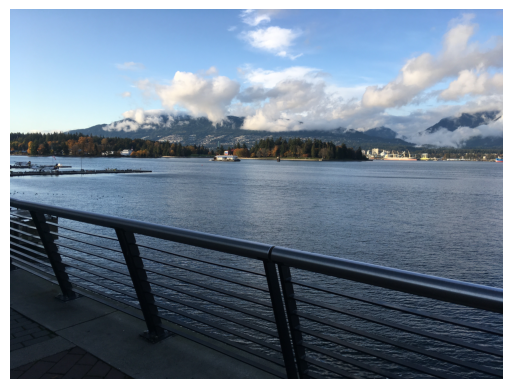

Top left quadrant proportion: 0.30459695452254976
Top right quadrant proportion: 0.2701916414714034
Bottom left quadrant proportion: 0.250710913223314
Top right quadrant proportion: 0.2946002089107248


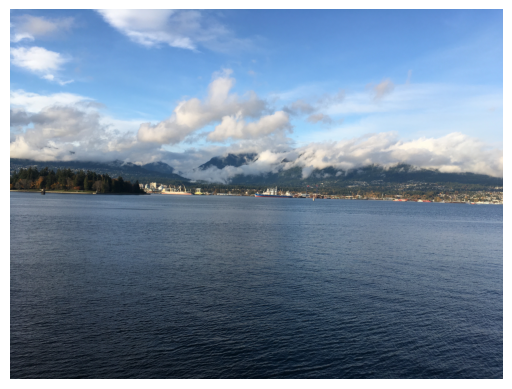

Top left quadrant proportion: 0.36898823958595783
Top right quadrant proportion: 0.31524359357940707
Bottom left quadrant proportion: 0.3732432208994709
Top right quadrant proportion: 0.586558523872512


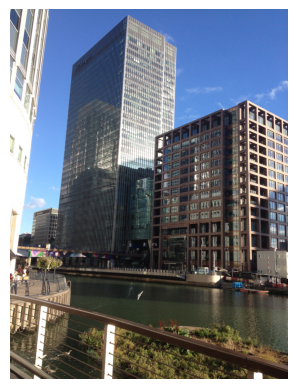

Top left quadrant proportion: 0.31227823032807894
Top right quadrant proportion: 0.48488011421889016
Bottom left quadrant proportion: 0.005040128796616686
Top right quadrant proportion: 0.010273492566961424


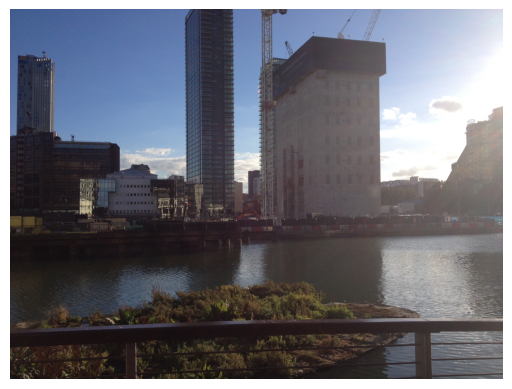

Top left quadrant proportion: 0.5647201997629117
Top right quadrant proportion: 0.10665218906189927
Bottom left quadrant proportion: 0.014964697071639114
Top right quadrant proportion: 2.8034089452774574e-05


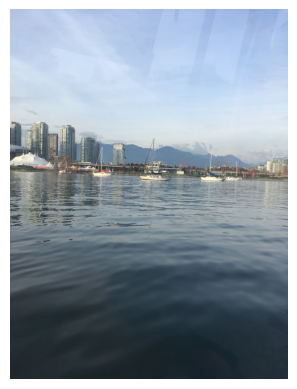

Top left quadrant proportion: 0.045419711094314266
Top right quadrant proportion: 0.08961213729318888
Bottom left quadrant proportion: 0.06653157018980432
Top right quadrant proportion: 0.24642935878054925


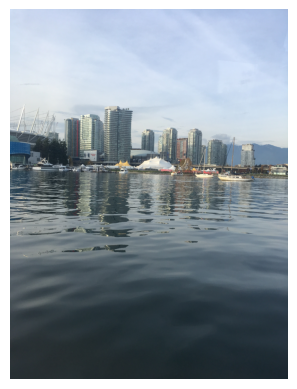

Top left quadrant proportion: 0.047192565297724025
Top right quadrant proportion: 0.05579733822541362
Bottom left quadrant proportion: 0.04242514907197447
Top right quadrant proportion: 0.1517119000377929


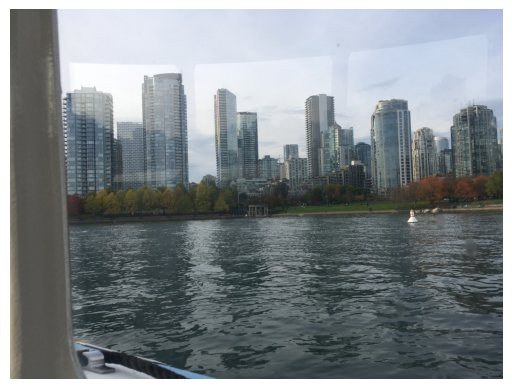

Top left quadrant proportion: 0.038373567019400354
Top right quadrant proportion: 0.03219777494331066
Bottom left quadrant proportion: 0.008263587070630721
Top right quadrant proportion: 0.0011852927899554883


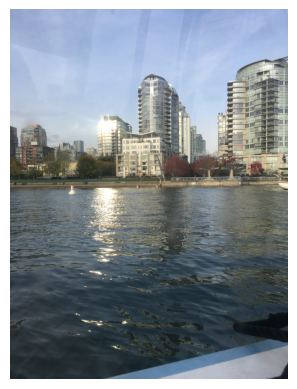

Top left quadrant proportion: 0.18961994520030234
Top right quadrant proportion: 0.17199179054337785
Bottom left quadrant proportion: 0.09125770292684975
Top right quadrant proportion: 0.15980981512975562


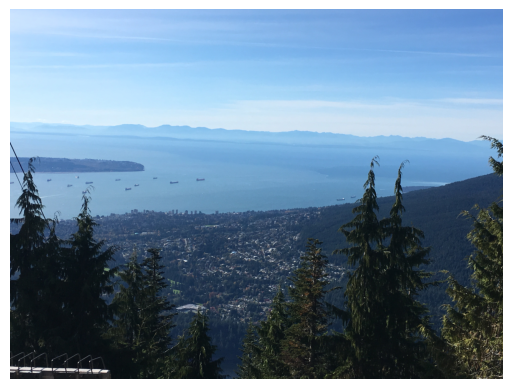

Top left quadrant proportion: 0.2510573480935584
Top right quadrant proportion: 0.473781179138322
Bottom left quadrant proportion: 0.33195645156210635
Top right quadrant proportion: 0.17283064846308893


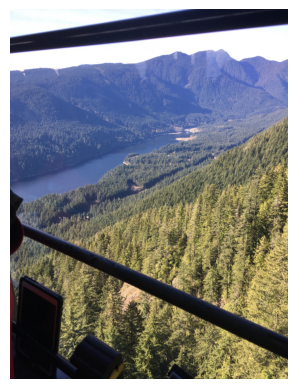

Top left quadrant proportion: 0.6484739150289746
Top right quadrant proportion: 0.4331009988872092
Bottom left quadrant proportion: 0.03886500587889477
Top right quadrant proportion: 0.0016170241244646006


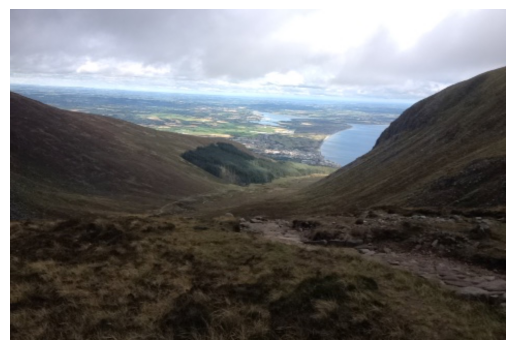

Top left quadrant proportion: 0.0740625
Top right quadrant proportion: 0.06885416666666666
Bottom left quadrant proportion: 0.0
Top right quadrant proportion: 0.0


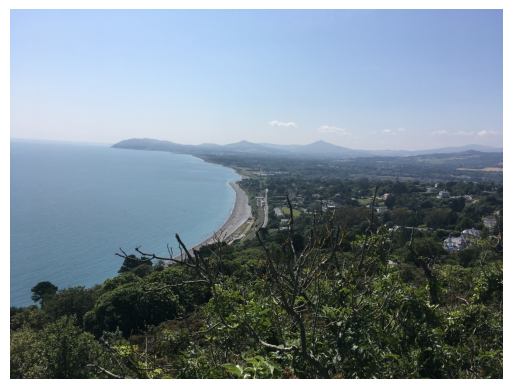

Top left quadrant proportion: 0.21887171149323928
Top right quadrant proportion: 0.4266381514025363
Bottom left quadrant proportion: 0.3570122879398673
Top right quadrant proportion: 0.002140941253044428


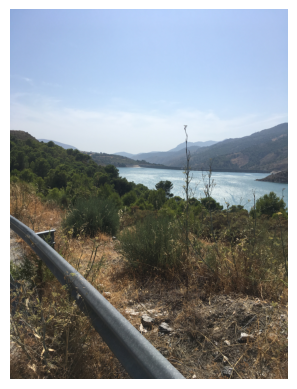

Top left quadrant proportion: 0.1009834682329722
Top right quadrant proportion: 0.09313192869740489
Bottom left quadrant proportion: 3.280633240950701e-07
Top right quadrant proportion: 0.0006856523473586965


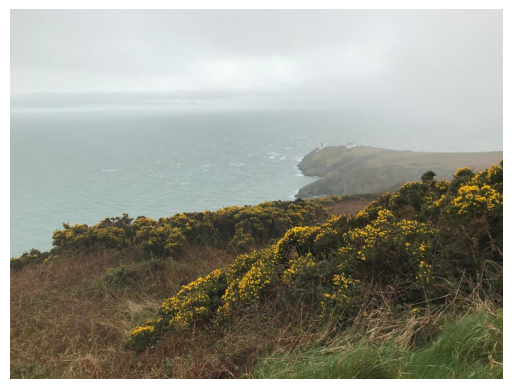

Top left quadrant proportion: 0.0
Top right quadrant proportion: 0.0
Bottom left quadrant proportion: 0.0
Top right quadrant proportion: 0.0


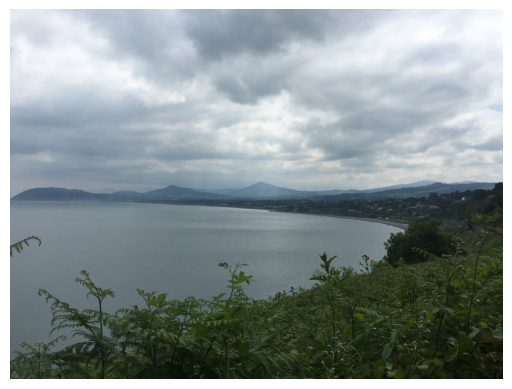

Top left quadrant proportion: 0.02490230274208449
Top right quadrant proportion: 0.031724707629965564
Bottom left quadrant proportion: 0.05118640820525741
Top right quadrant proportion: 0.025113247459477617


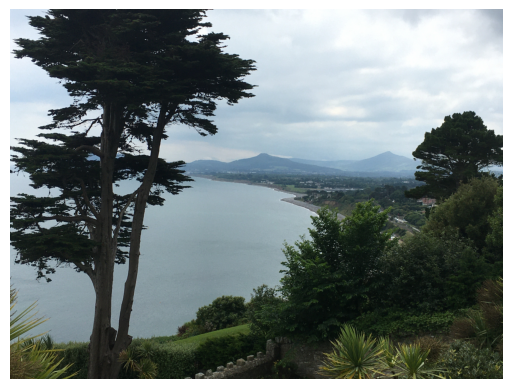

Top left quadrant proportion: 0.037605570777693796
Top right quadrant proportion: 0.0984675506004871
Bottom left quadrant proportion: 0.0015789687788695726
Top right quadrant proportion: 0.0004517431972789116


In [104]:
for folder in subfolders:
    image_paths = [os.path.join(folder, f) for f in os.listdir(folder) if f.endswith(('.JPG', '.jpeg', '.jpg'))][-4:]
    for image_path in image_paths:
        plot_image(image_path) 
        features = calculate_features(image_path)
        print(f'Top left quadrant proportion: {features[0]}')
        print(f'Top right quadrant proportion: {features[1]}')
        print(f'Bottom left quadrant proportion: {features[2]}')
        print(f'Top right quadrant proportion: {features[3]}')   



Below I store the labels and store the features in a design matrix I can feed into the classification models.

In [105]:
labels = []
design_matrix = []

directory = './Water_body_images/'

# Loop through subfolders
for folder_name in os.listdir(directory):
    if os.path.isdir(os.path.join(directory, folder_name)):
        class_label = folder_name[0]  # Get the first character as class label

        # Process each image in the folder
        for image_file in os.listdir(os.path.join(directory, folder_name)):
            if image_file.lower().endswith(('.JPG', '.jpeg', '.jpg')):
                image_path = os.path.join(directory, folder_name, image_file)

                # Append class label
                labels.append(class_label)

                # Get and append features
                features = calculate_features(image_path)
                design_matrix.append(features)

# Convert to numpy arrays
labels = np.array(labels)
design_matrix = np.array(design_matrix)

In [106]:
labels

array(['2', '2', '2', '2', '2', '2', '2', '1', '1', '1', '1', '1', '1',
       '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1',
       '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '0', '0', '0',
       '0', '0', '0', '0', '0', '4', '4', '4', '4', '4', '3', '3', '3',
       '3', '3', '3', '3', '3', '3', '3', '3'], dtype='<U1')

In [107]:
len(labels)

60

In [108]:
design_matrix[:2]

array([[7.59041425e-01, 5.73743714e-01, 5.18579538e-02, 1.93016057e-02,
        5.92765455e+01, 1.52587891e-05, 5.23338349e+00, 9.84052502e-01],
       [4.65476584e-01, 2.07576163e-01, 2.90420026e-01, 1.03368489e-01,
        4.56080727e+01, 1.52587891e-05, 5.16039330e+00, 9.22227418e-01]])

Below I test an SVM classifier with the default parameter values

In [109]:
# Assuming 'labels' and 'design_matrix' are your data
svm_model = SVC()  # Initialize the SVM model

# Define a custom scorer for misclassification rate
def misclassification_rate(y_true, y_pred):
    return 1 - accuracy_score(y_true, y_pred)

misclass_scorer = make_scorer(misclassification_rate)

# Perform 5-fold cross-validation
misclass_rates = cross_val_score(svm_model, design_matrix, labels, cv=5, scoring=misclass_scorer)

# Calculate the average misclassification rate
average_misclass_rate = np.mean(misclass_rates)
print("Average Misclassification Rate:", average_misclass_rate)


Average Misclassification Rate: 0.5166666666666666


Now I tune parameters using Grid Search

In [110]:
# Define parameter grid
param_grid_svm  = {'C':[0.1,1,10,100], 'gamma':['scale'],'kernel': ['linear','rbf']}

# Initialize SVM and GridSearchCV
svm_model = SVC()
grid_search_svm = GridSearchCV(svm_model, param_grid_svm, cv=5)

# Perform grid search
grid_search_svm.fit(design_matrix, labels)

# Retrieve the best parameters
best_params_svm = grid_search_svm.best_params_
print("Best Parameters for SVM:", best_params_svm)

# Initialize SVM with the best parameters
optimized_svm_model = SVC(C=best_params_svm['C'], 
                          gamma=best_params_svm['gamma'], 
                          kernel=best_params_svm['kernel'])

# Perform 5-fold cross-validation
misclass_rates_optimized = cross_val_score(optimized_svm_model, design_matrix, labels, cv=5, scoring=misclass_scorer)

# Calculate the average misclassification rate
average_misclass_rate_optimized = np.mean(misclass_rates_optimized)
print("Average Misclassification Rate:", average_misclass_rate_optimized)


Best Parameters for SVM: {'C': 10, 'gamma': 'scale', 'kernel': 'linear'}
Average Misclassification Rate: 0.4999999999999999


Now find misclassification rate for only images labelled as immediate vicinity or close for SVM..

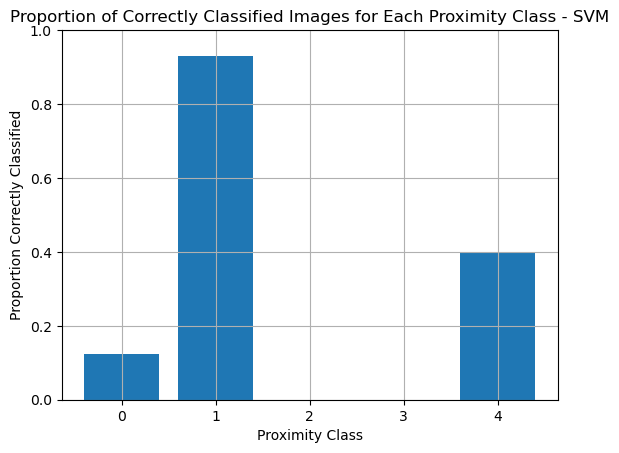

In [122]:
# Generate cross-validated estimates for each input data point
predicted_labels = cross_val_predict(optimized_svm_model, design_matrix, labels, cv=5)

# Calculate the confusion matrix
cm = confusion_matrix(labels, predicted_labels)

# Calculate the proportion of correctly classified images for each class
proportion_correctly_classified = cm.diagonal() / cm.sum(axis=1)

# Plotting the bar chart
class_labels = np.unique(labels)  # Replace with your actual class names if available
plt.bar(class_labels, proportion_correctly_classified)
plt.xlabel('Proximity Class')
plt.ylabel('Proportion Correctly Classified')
plt.grid()
plt.title('Proportion of Correctly Classified Images for Each Proximity Class - SVM')
plt.yticks(np.arange(0.0, 1.01, 0.2))
plt.show()


In [117]:
# Assuming 'labels' and 'design_matrix' are your data
rf_model = RandomForestClassifier()  # Initialize the Random Forest model

# Perform 5-fold cross-validation
misclass_rates = cross_val_score(rf_model, design_matrix, labels, cv=5, scoring=misclass_scorer)

# Calculate the average misclassification rate
average_misclass_rate = np.mean(misclass_rates)
print("Average Misclassification Rate:", average_misclass_rate)


Average Misclassification Rate: 0.5499999999999999


In [116]:
# Define parameter grid for Random Forest
param_grid_rf = {
    'n_estimators': [50, 100, 500, 1000],
    'max_features': ['sqrt'],
    'max_depth': [5,7,10],
    'min_samples_split': [4,6,8,10],
    'min_samples_leaf': [1,2,3,4],
}

# Initialize Random Forest and GridSearchCV
rf_model = RandomForestClassifier()
grid_search_rf = GridSearchCV(rf_model, param_grid_rf, cv=5)

# Perform grid search
grid_search_rf.fit(design_matrix, labels)

# Retrieve the best parameters
best_params_rf = grid_search_rf.best_params_
print("Best Parameters for Random Forest:", best_params_rf)

# Initialize Random Forest with the best parameters
optimized_rf_model = RandomForestClassifier(n_estimators=best_params_rf['n_estimators'],
                                            max_features=best_params_rf['max_features'],
                                            max_depth=best_params_rf['max_depth'],
                                            min_samples_split=best_params_rf['min_samples_split'],
                                            min_samples_leaf=best_params_rf['min_samples_leaf'])

# Define a custom scorer for misclassification rate
def misclassification_rate(y_true, y_pred):
    return 1 - accuracy_score(y_true, y_pred)

misclass_scorer = make_scorer(misclassification_rate)

# Perform 5-fold cross-validation
misclass_rates_optimized = cross_val_score(optimized_rf_model, design_matrix, labels, cv=5, scoring=misclass_scorer)

# Calculate the average misclassification rate
average_misclass_rate_optimized = np.mean(misclass_rates_optimized)
print("Average Misclassification Rate:", average_misclass_rate_optimized)


Best Parameters for Random Forest: {'max_depth': 5, 'max_features': 'sqrt', 'min_samples_leaf': 4, 'min_samples_split': 8, 'n_estimators': 100}
Average Misclassification Rate: 0.55


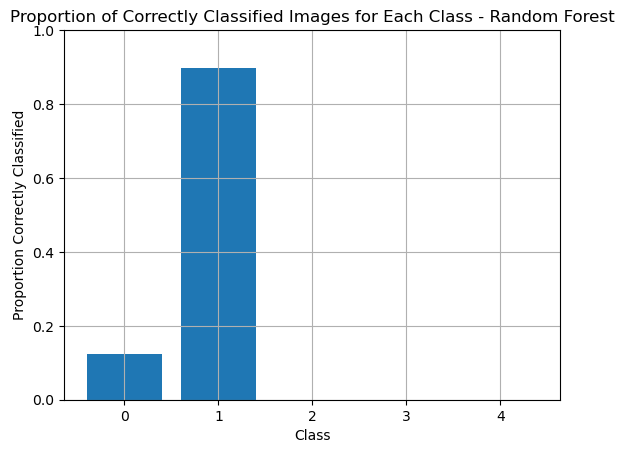

In [124]:
# Generate cross-validated estimates for each input data point
predicted_labels = cross_val_predict(optimized_rf_model, design_matrix, labels, cv=5)

# Calculate the confusion matrix
cm = confusion_matrix(labels, predicted_labels)

# Calculate the proportion of correctly classified images for each class
proportion_correctly_classified = cm.diagonal() / cm.sum(axis=1)

# Plotting the bar chart
class_labels = np.unique(labels)  # Replace with your actual class names if available
plt.bar(class_labels, proportion_correctly_classified)
plt.xlabel('Class')
plt.ylabel('Proportion Correctly Classified')
plt.grid()
plt.title('Proportion of Correctly Classified Images for Each Class - Random Forest')
plt.yticks(np.arange(0.0, 1.01, 0.2))
plt.show()

The above results are expected given the imbalanced dataset. The model is very good at predicting the most common class but much weaker at others. I tested another folder with reduced sample of 1_close but the overall misclassification rate went up.